In [ ]:
import tensorflow as tf
from tensorflow import keras
print(tf.__version__)


2.9.2


In [ ]:
!pip install -U tensorflow-addons

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.1/1.1 MB 17.0 MB/s eta 0:00:00


In [ ]:
import sys
!{sys.executable} -m pip install scipy

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [ ]:
import numpy as np
import tensorflow_addons as tfa
import matplotlib.pyplot as plt
from tensorflow.keras.optimizers import Adam
import pandas as pd
import seaborn as sns
from tensorflow.keras import Sequential
from tensorflow.keras.optimizers import SGD
from tensorflow.keras.layers import Dense, Dropout
from tensorflow.keras.layers import Embedding
from tensorflow.keras.layers import LSTM
from sklearn.metrics import accuracy_score
from sklearn.model_selection import train_test_split
from tensorflow.keras.utils import to_categorical
from sklearn.preprocessing import StandardScaler

In [ ]:
df=pd.read_csv('/content/drive/MyDrive/Colab_Notebooks/Emotional Dataset/emotions.csv')
print(df.head())

   # mean_0_a  mean_1_a  mean_2_a  mean_3_a  mean_4_a  mean_d_0_a  mean_d_1_a  \
0        4.62      30.3    -356.0      15.6      26.3       1.070       0.411   
1       28.80      33.1      32.0      25.8      22.8       6.550       1.680   
2        8.90      29.4    -416.0      16.7      23.7      79.900       3.360   
3       14.90      31.6    -143.0      19.8      24.3      -0.584      -0.284   
4       28.30      31.3      45.2      27.3      24.5      34.800      -5.790   

   mean_d_2_a  mean_d_3_a  mean_d_4_a  ...  fft_741_b  fft_742_b  fft_743_b  \
0      -15.70        2.06        3.15  ...       23.5       20.3       20.3   
1        2.88        3.83       -4.82  ...      -23.3      -21.8      -21.8   
2       90.20       89.90        2.03  ...      462.0     -233.0     -233.0   
3        8.82        2.30       -1.97  ...      299.0     -243.0     -243.0   
4        3.06       41.40        5.52  ...       12.0       38.1       38.1   

   fft_744_b  fft_745_b  fft_746_b  ff

# mean_0_a    0
mean_1_a      0
mean_2_a      0
mean_3_a      0
mean_4_a      0
             ..
fft_746_b     0
fft_747_b     0
fft_748_b     0
fft_749_b     0
label         0
Length: 2549, dtype: int64

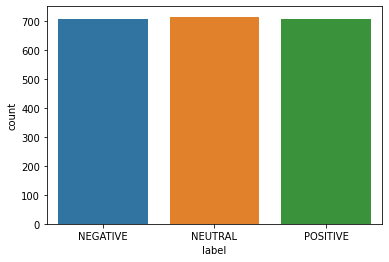

In [ ]:
sns.countplot(x='label',data=df)
df.isnull().sum()


In [ ]:
encode=({'NEUTRAL':0,'POSITIVE':1,'NEGATIVE':2})
df_encoded=df.replace(encode)
print(df_encoded['label'].value_counts())

0    716
2    708
1    708
Name: label, dtype: int64


In [ ]:
x=df_encoded.drop(["label"],axis=1)


In [ ]:
print(x.shape)

(2132, 2548)


In [ ]:
y=df_encoded.loc[:,'label'].values
print(y.shape)

(2132,)


In [ ]:
scaler = StandardScaler()
scaler.fit(x)
x = scaler.transform(x)
y = to_categorical(y)
print(y)

[[0. 0. 1.]
 [1. 0. 0.]
 [0. 1. 0.]
 ...
 [0. 0. 1.]
 [0. 0. 1.]
 [1. 0. 0.]]


In [ ]:
x = x / np.amax(x)

In [ ]:
x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.2, random_state=4)

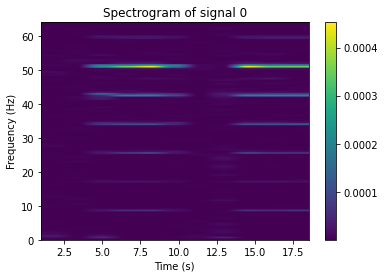

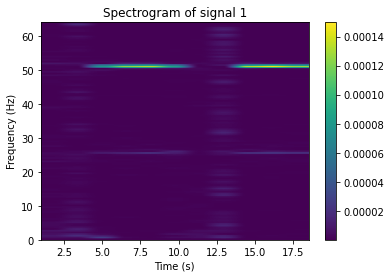

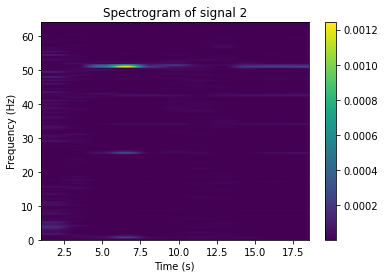

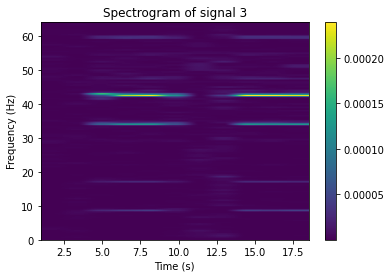

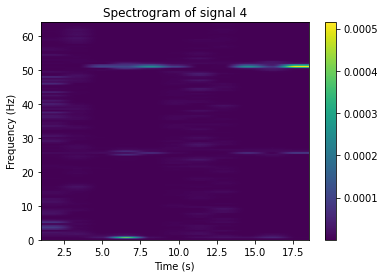

...

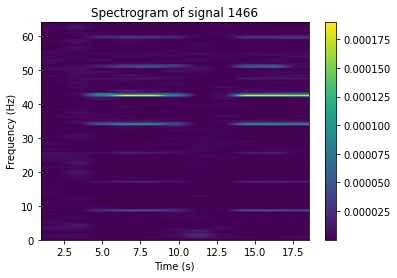

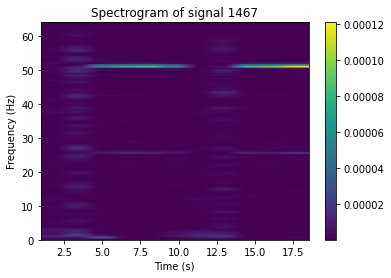

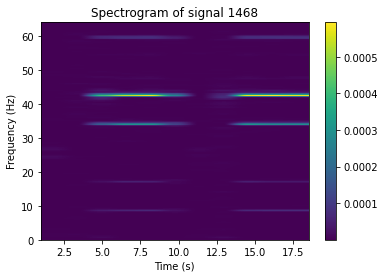

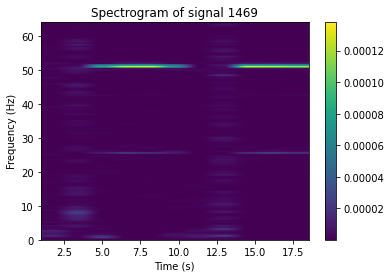

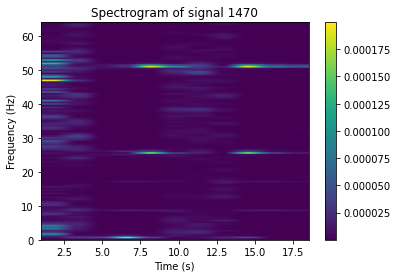

In [ ]:
from scipy import signal
from scipy.signal import spectrogram
import matplotlib.pyplot as plt
# Define the parameters for the spectrogram analysis
fs = 128  # Sampling frequency
nfft = 128  # Number of FFT points
noverlap = nfft / 2  # Number of points to overlap between segments

# Perform the spectrogram analysis on each signal
for i, signal in enumerate(x):
    f, t, Sxx = spectrogram(signal, fs)

    plt.imshow(Sxx, aspect='auto', origin='lower', extent=[t[0], t[-1], f[0], f[-1]])
    plt.title('Spectrogram of signal ' + str(i))
    plt.xlabel('Time (s)')
    plt.ylabel('Frequency (Hz)')
    plt.colorbar()
    plt.show()